In [3]:
import numpy as np
import pandas as pd
import time
import pickle
import warnings
from tqdm import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torch.utils.data import DataLoader
from torch import nn, optim
from torch.nn import functional as F

from structure.data import HMM_Data
from structure.model import ConvNet
from structure.pattern import PatternMatching
from structure.graphics import visualize_secondary_structure
from structure.utils import *
from structure.data_extraction import from_fasta_to_df, from_df_to_fasta

from pgm.data import SequenceStructureData
from pgm.layers import GaussianLayer, OneHotLayer, DReLULayer
from pgm.edge import Edge
from pgm.model import MRF
from pgm.metrics import aa_acc, l1b_reg, msa_mean, ZeroSumGauge
from pgm.ais import AIS

torch.cuda.is_available()
device = torch.device('cpu')
warnings.filterwarnings("ignore")

In [4]:
AMINO_ACIDS = 'ACDEFGHIKLMNPQRSTVWY'
DATA = "/home/cyril/Documents/These/data/"
DATASET = "PF00397"

batch_size = 300
q = 21
N = 31
k = 10
lamb_l1b = 0.025
gamma = lamb_l1b/(2*q*N)

## SS3 prediction

In [15]:
class HMM_Data(object):
    def __init__(self, file):
        self.primary, self.ss3 = [], []
        data = pickle.load(open(file, 'rb'))
        self.primary = [p[:,:50] for p in data.values()]

    def __len__(self):
        return len(self.primary)
    
    def __getitem__(self, i):
        return self.primary[i]
    
def predict():
    mean_ss3_acc, mean_ss8_acc, n_res = 0,0,0
    model.eval()
#     denoiser.eval()
    predictions = []
    for batch_idx, data in enumerate(loader):
#         if batch_idx == 300:
#             break
        x = data.float().permute(0, 2, 1).to(device)[:,:40]
        B,_,N = x.size()

        optimizer.zero_grad()
        p_other, p_ss8, p_ss3 = model(x)
        p_other, p_ss8, p_ss3 = p_other.cpu(), p_ss8.cpu(), p_ss3.cpu()
        x = x.cpu()
        
        p_ss3 = F.softmax(p_ss3,1)
        p_ss8 = F.softmax(p_ss8,1)
        predictions.append(p_ss3[0].permute(1,0).detach().numpy())

    return predictions

In [5]:
dataset = HMM_Data(f"{DATA}/{DATASET}/hmm.pkl")
loader = DataLoader(dataset, batch_size = 1,
                        shuffle=False, drop_last=False)

In [6]:
N, qx, qs, h = 128, 40, 3, 8
# del model
device = torch.device('cuda')

# del model
model = ConvNet(qx, qs)
model = model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
model.load_state_dict(torch.load(f"{DATA}/secondary_structure/model_40feats.h5"))
start = time.time()

model

ConvNet(
  (conv1): ResBlock(
    (conv_1): ConvBlock(
      (conv): Conv1d(40, 100, kernel_size=(11,), stride=(1,), padding=(5,))
      (activation): LeakyReLU(negative_slope=0.2)
      (normalization): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (conv2): ConvBlock(
      (conv): Conv1d(40, 100, kernel_size=(1,), stride=(1,))
      (normalization): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (conv2): ResBlock(
    (conv_1): ConvBlock(
      (conv): Conv1d(100, 200, kernel_size=(11,), stride=(1,), padding=(5,))
      (activation): LeakyReLU(negative_slope=0.2)
      (normalization): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (conv2): ConvBlock(
      (conv): Conv1d(100, 200, kernel_size=(1,), stride=(1,))
      (normalization): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (conv3): ResBlock(
    (c

In [ ]:
ss_prediction = predict()
keys = pickle.load(open(f"{DATA}/{DATASET}/keys.pkl","rb"))
pickle.dump({k:v for k,v in zip(keys,ss_prediction)}, open(f"{DATA}/{DATASET}/ss3.pkl", "wb"))

## Pattern Matching

In [20]:
n_patterns, c_patterns, _ =  pickle.load(open(f"{DATA}/{DATASET}/patterns.pkl","rb"))
regexes = []
for x in n_patterns:
    if len(x):
        regexes.append([(i,None,None) for i in x])
Q,T,pi = pickle.load(open(f"{DATA}/secondary_structure/statistics.pkl", "rb"))
matcher = [PatternMatching(pattern = regex, 
                            Q = Q, T = T, pi = pi,
                            name = name, 
                            MAX_SIZE = 100) for regex, name in zip(regexes, c_patterns)][0]

In [21]:
data = pickle.load(open(f"{DATA}/{DATASET}/ss3.pkl","rb"))

In [22]:
costs = []
costs2 = dict()
ss = dict()
transitions = dict()
len_pat = len(matcher.pattern)
for j, k in tqdm(enumerate(data.keys())):
#     for j, (k,v) in enumerate(ss3_dict.items()):
#         print(f"Step {i}/{len(matchers)} : [{int(100*j/len(data))}%]", end="\r")
    sample = torch.tensor(data[k])
    N = sample.shape[0]
    p, ll, a, b, P ,Q = matcher.match(sample)
    transition = a[:-1].view(len_pat,-1,1)+b[1:].view(len_pat,1,-1)+P[0, matcher.pattern]+Q[0, matcher.pattern]-a[-1,-1]
    transitions[k] = transition
    costs2[k] = (ll,a[-1,-1])
    ss[k] = p

for k, t in transitions.items():
    t = t - torch.log(torch.exp(t).sum(2).sum(1)).view(-1,1,1)
    tr = []
    for i in range(10):
        tr.append(np.trace(torch.exp(t).numpy(), offset = i, axis1 = 1, axis2 = 2))
    tr = np.array(tr).T
    transitions[k] = tr.argmax(1)

852it [00:02, 292.83it/s]


KeyboardInterrupt: 

In [19]:
AMINO_ACIDS = '-ACDEFGHIKLMNPQRSTVWY'
AA_IDS = {l: i for i, l in enumerate(AMINO_ACIDS)}

In [44]:
df = from_fasta_to_df(f"{DATA}/{DATASET}/aligned.fasta")

raw_sequences = np.array(list(df["aligned_seq"].apply(lambda s: np.array([AA_IDS[c] if c in AA_IDS.keys() else -1 for c in s]))))
del df

ss_sequences = np.zeros(raw_sequences.shape)
for i,(x,s) in tqdm(enumerate(zip(raw_sequences,ss.values()))):
    idx = np.where(x > 0)[0]
    ss_sequences[i,idx] = s.numpy()+1

ss_transitions = np.zeros((raw_sequences.shape[0],7))
for i,(x,s) in tqdm(enumerate(zip(raw_sequences,transitions.values()))):
    ss_transitions[i] = s

idx = ((raw_sequences == -1).max(0) == False)
raw_sequences = raw_sequences[:, idx]
ss_sequences = ss_sequences[:, idx]
ss_sequences = np.array(ss_sequences, dtype=int)
ss_transitions = np.array(ss_transitions, dtype=int)

raw_sequences = np.array([to_onehot(seq, (None, len(AA_IDS))) for seq in raw_sequences])
ss_sequences = np.array([to_onehot(seq, (None, 4)) for seq in ss_sequences])
ss_transitions = np.array([to_onehot(seq, (None, 10)) for seq in ss_transitions])

pickle.dump([raw_sequences, ss_sequences, ss_transitions], open(f"{DATA}/{DATASET}/RBM_fullset.pkl", "wb"))

9904it [00:00, 114227.70it/s]
9904it [00:00, 954271.37it/s]


## Data

In [5]:
filename = "RBM_fullset"
train_dataset = SequenceStructureData(f"{DATA}/{DATASET}/{filename}.pkl")
train_loader = DataLoader(train_dataset, batch_size = batch_size, 
                          shuffle = True, drop_last=True)

In [6]:
pots = np.zeros((train_dataset.raw_sequences.shape[1], train_dataset.raw_sequences.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.raw_sequences):
    pots += w*v
pots /= np.sum(train_dataset.weights)
pots = pots.T
pots = torch.FloatTensor((pots.T-np.mean(pots, 1)).T).view(-1).to(device)

In [7]:
pots2 = np.zeros((train_dataset.ss_sequences.shape[1], train_dataset.ss_sequences.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.ss_sequences):
    pots2 += w*v
pots2 /= np.sum(train_dataset.weights)
pots2 = pots2.T
pots2 = torch.FloatTensor((pots2.T-np.mean(pots2, 1)).T).view(-1).to(device)

In [8]:
pots3 = np.zeros((train_dataset.ss_transitions.shape[1], train_dataset.ss_transitions.shape[2]))
for w, v in zip(train_dataset.weights,train_dataset.ss_transitions):
    pots3 += w*v
pots3 /= np.sum(train_dataset.weights)
pots3 = pots3.T
pots3 = torch.FloatTensor((pots3.T-np.mean(pots3, 1)).T).view(-1).to(device)

## RBM

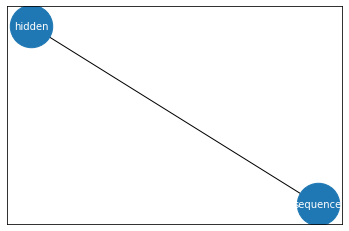

In [13]:
LAYERS_NAME = ["sequence", "structure", "transitions"]
VISIBLE_LAYERS = ["sequence"]
HIDDEN_LAYER = "hidden"


v = OneHotLayer(pots, N = 31, q = 21, name = "sequence")
s = OneHotLayer(pots2, N = 31, q = 4, name = "structure")
t = OneHotLayer(pots3, N = 31, q = 4, name = "transition")
h = DReLULayer(N = 100, name = "hidden")

E = [(v.name, h.name), 
#      (s.name, h.name),
#      (t.name, h.name),
    ]

model = MRF(layers = {v.name: v, 
#                       s.name: s, 
#                       t.name:t,
                      h.name: h},
            edges = E).to(device)

for visible in VISIBLE_LAYERS:
    edge = model.get_edge(visible, HIDDEN_LAYER)
    edge.gauge = edge.gauge.to(device)

optimizer = optim.Adam(model.parameters(), lr=0.001)

In [ ]:
start = time.time()
model.train()
in_lays, out_lays = ["sequence"], ["hidden"]
edge = model.get_edge("sequence", "hidden")
edge.gauge = edge.gauge.to(device)
# ais = AIS(model, p0)
mean_loss, mean_reg, mean_acc = 0, 0, 0
Z = 0
for epoch in range(6000):
        # Z estimation
    m, s = int(time.time()-start)//60, int(time.time()-start)%60
#     if not epoch%100:
#         ais.update(model)
#         Z = ais.run(20, 1000)
#         print(f'''Train Epoch: {epoch} [100%] || Time: {m} min {s} || Loss: {mean_loss-Z:.3f} || Reg: {mean_reg:.3f} || Acc: {mean_acc:.3f}''', end="\t")
#         print()

    mean_loss, mean_reg, mean_acc = 0, 0, 0
    for batch_idx, data in enumerate(train_loader):
        x = data[0].float().permute(0, 2, 1).to(device)
        w = data[-1].float().to(device)
        
        # Sampling
        d_0 = {"sequence":x}
        d_0, d_f = model.gibbs_sampling(d_0, in_lays, out_lays, k = 10)
        
        # Optimization
        optimizer.zero_grad()
        e_0, e_f = model(d_0), model(d_f)
        reg = l1b_reg(edge)
        loss = msa_mean(e_f-e_0, w).clamp(-100, 100) + gamma * reg
        loss.backward()
        optimizer.step()
        
        
        # Metrics
        d_0, d_f = model.gibbs_sampling(d_0, in_lays, out_lays, k = 1)
        acc = aa_acc(d_0["sequence"].view(*x.size()), d_f["sequence"].view(*x.size()))
        ll = msa_mean(model.integrate_likelihood(d_f, "hidden"),w)/31
        mean_loss = (mean_loss*batch_idx + ll.item())/ (batch_idx+1)
        mean_reg = (mean_reg*batch_idx + gamma*reg)/(batch_idx+1)
        mean_acc = (mean_acc*batch_idx + acc)/(batch_idx+1)
        m, s = int(time.time()-start)//60, int(time.time()-start)%60

    print(f'''Train Epoch: {epoch} [100%] || Time: {m} min {s} || Loss: {mean_loss-Z:.3f} || Reg: {mean_reg:.3f} || Acc: {mean_acc:.3f}''', end="\r")

In [ ]:
LAYERS_NAME = ["sequence", "structure", "transitions"]
VISIBLE_LAYERS = ["sequence"]
HIDDEN_LAYER = "hidden"

def train(epochs = 6000):
    start = time.time()
    model.train()
    mean_loss, mean_reg, mean_acc = 0, 0, 0
    for epoch in range(epochs):
        # Z estimation
        m, s = int(time.time()-start)//60, int(time.time()-start)%60
        mean_loss, mean_reg, mean_acc = 0, 0, 0
        for batch_idx, data in enumerate(train_loader):
            d_0 = {k:v.float().permute(0, 2, 1).to(device) for k,v in zip(LAYERS_NAME, data[:-1]) if k in VISIBLE_LAYERS}
            w = data[-1].float().to(device)

            # Sampling
            d_0, d_f = model.gibbs_sampling(d_0, in_lays, out_lays, k = 10)

            # Optimization
            optimizer.zero_grad()
            e_0, e_f = model(d_0), model(d_f)
            reg = l1b_reg(edge)
            loss = msa_mean(e_f-e_0, w).clamp(-100, 100) + gamma * reg
            loss.backward()
            optimizer.step()

            # Metrics
            d_0, d_f = model.gibbs_sampling(d_0, in_lays, out_lays, k = 1)
            acc = aa_acc(d_0["sequence"].view(*x.size()), d_f["sequence"].view(*x.size()))
            ll = msa_mean(model.integrate_likelihood(d_f, "hidden"),w)/31
            mean_loss = (mean_loss*batch_idx + ll.item())/ (batch_idx+1)
            mean_reg = (mean_reg*batch_idx + gamma*reg)/(batch_idx+1)
            mean_acc = (mean_acc*batch_idx + acc)/(batch_idx+1)
            m, s = int(time.time()-start)//60, int(time.time()-start)%60

        print(f'''Train Epoch: {epoch} [100%] || Time: {m} min {s} || Loss: {mean_loss-Z:.3f} || Reg: {mean_reg:.3f} || Acc: {mean_acc:.3f}''', end="\r")

### Secondary Structure

In [12]:
import sys

ROOT = "/home/cyril/Documents/These"
sys.path.append(f"{ROOT}/paper_codes/PGM3/source/")
sys.path.append(f"{ROOT}/paper_codes/PGM3/utilities/")

import Proteins_utils, sequence_logo, structure_logo, utilities10 as utilities, sequence_logo, structure_logo, plots_utils

def get_beta(W,include_gaps=False):
    if not include_gaps:
        W_ = W[:,:,:-1]
    else:
        W_ = W
    return  np.sqrt( (W_**2).sum(-1).sum(-1) ).numpy()

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


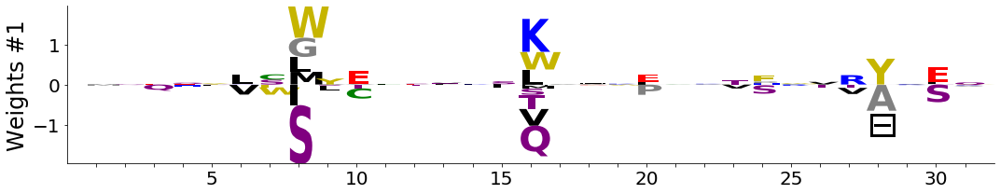

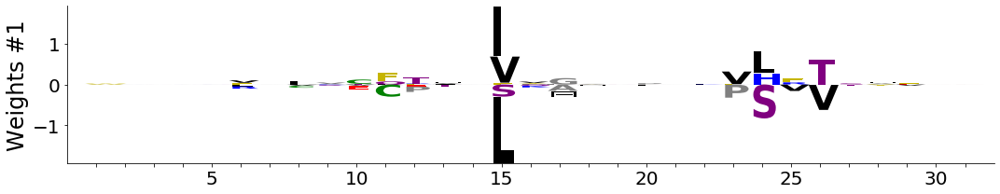

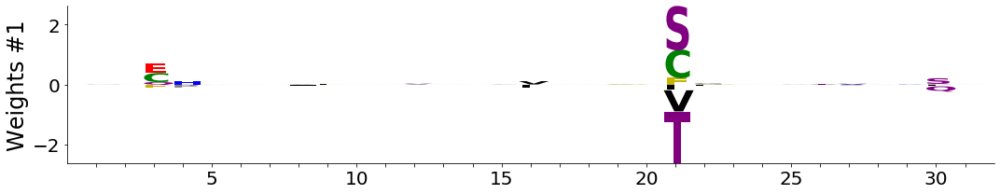

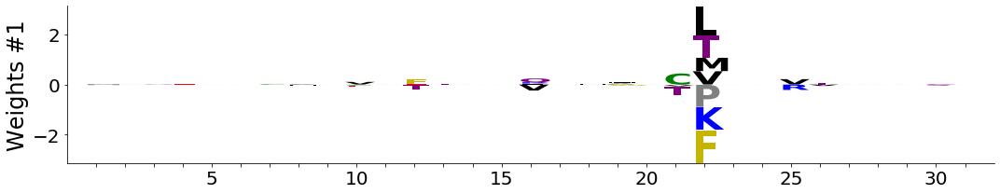

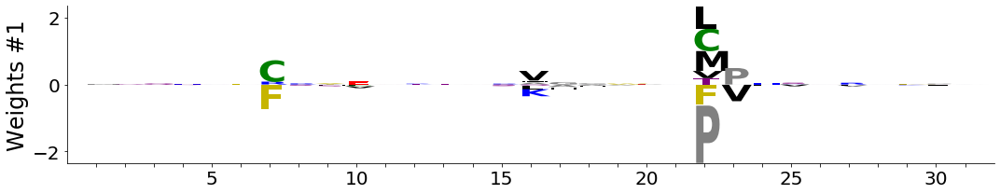

...

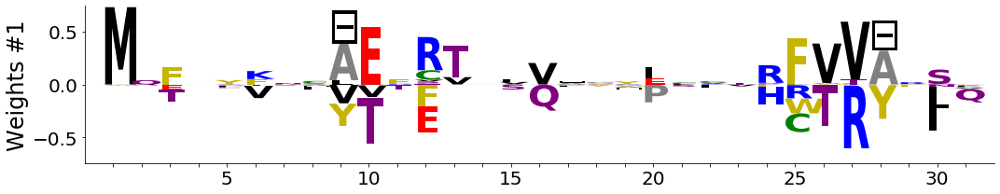

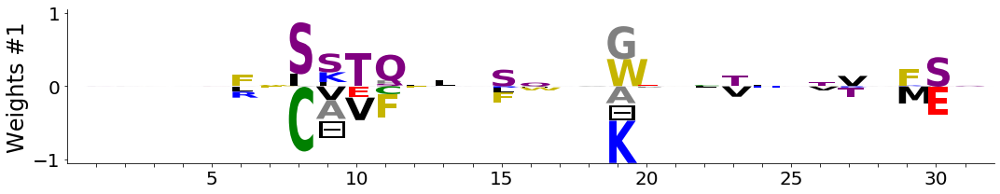

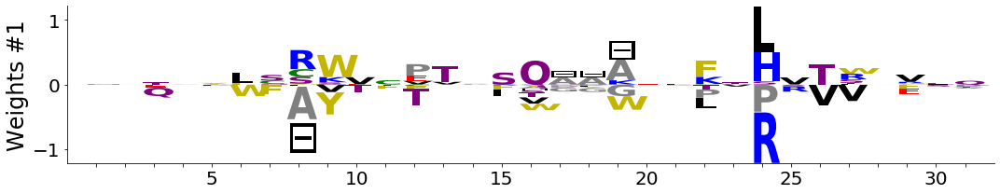

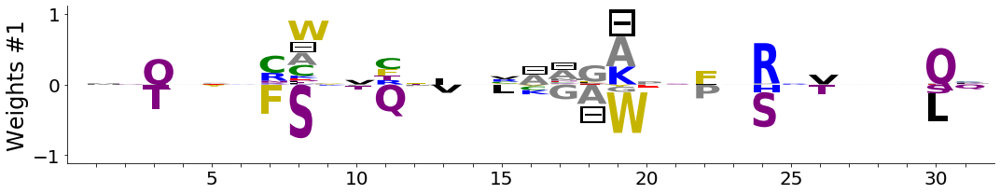

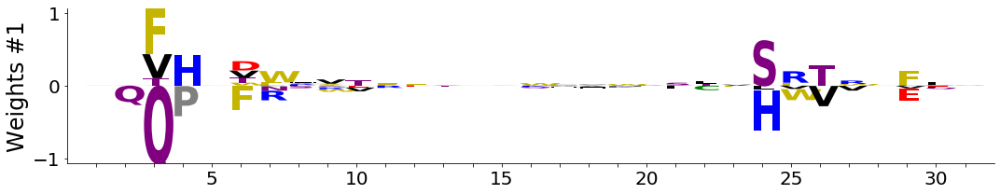

Error in callback <function flush_figures at 0x7fc43c69c320> (for post_execute):


KeyboardInterrupt: 

In [18]:
max_acti = model.get_edge("sequence", "hidden").get_weights().detach().view(-1, 21, 31).permute(0,2,1)
max_acti[:,:,0], max_acti[:,:,-1] = max_acti[:,:,-1], max_acti[:,:,0]
# max_acti2 = model.get_edge("structure", "hidden").get_weights().detach().view(-1, 4, 31).permute(0,2,1)

order = np.argsort(get_beta(max_acti))[::-1]
for i in order:
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)
#     structure_logo.Sequence_logo_multiple(max_acti2.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)

### Secondary structure length

In [21]:
import sys

ROOT = "/home/cyril/Documents/These"
sys.path.append(f"{ROOT}/paper_codes/PGM3/source/")
sys.path.append(f"{ROOT}/paper_codes/PGM3/utilities/")

import Proteins_utils, sequence_logo, structure_logo, utilities10 as utilities, sequence_logo, structure_logo, plots_utils

def get_beta(W,include_gaps=False):
    if not include_gaps:
        W_ = W[:,:,:-1]
    else:
        W_ = W
    return  np.sqrt( (W_**2).sum(-1).sum(-1) ).numpy()

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


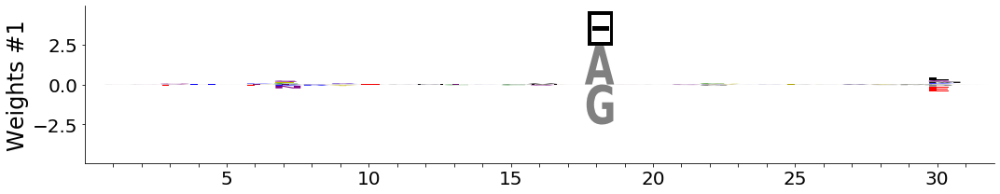

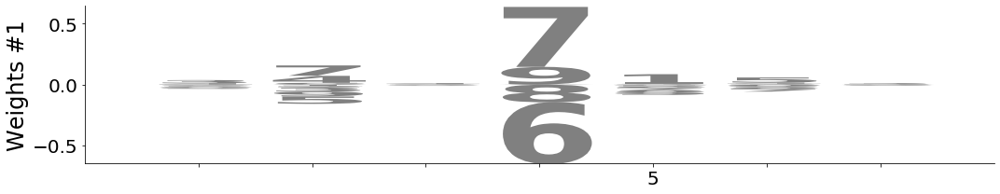

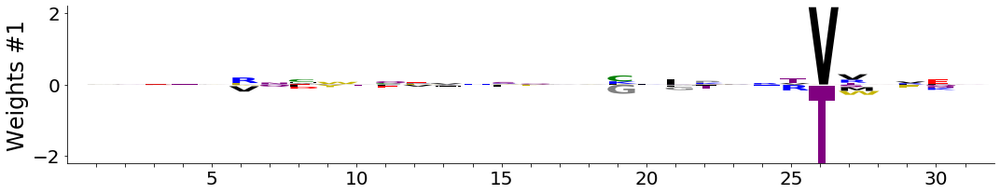

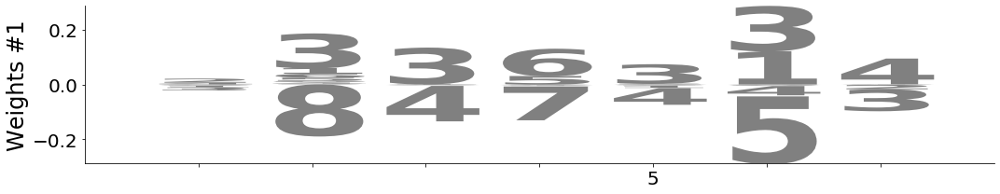

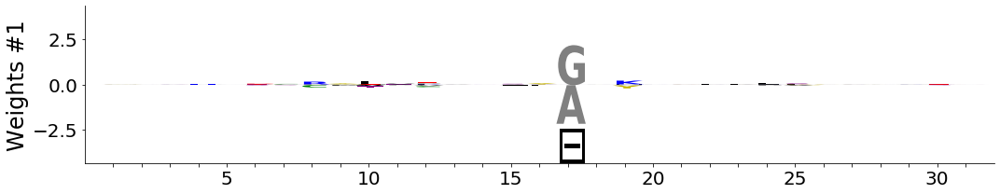

...

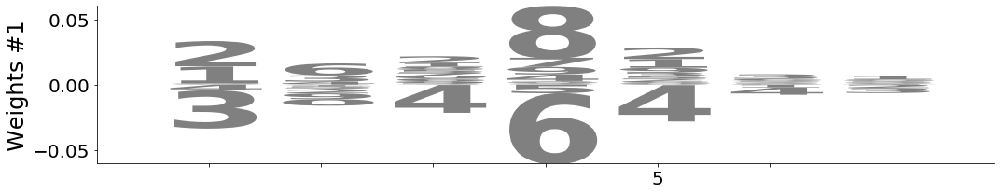

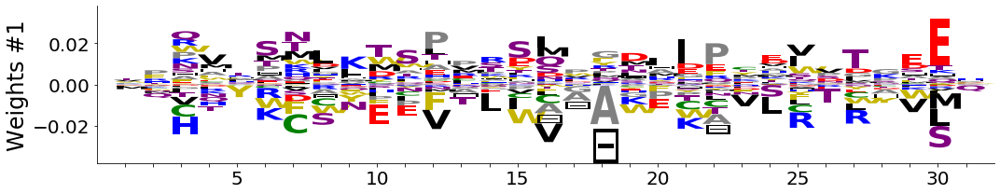

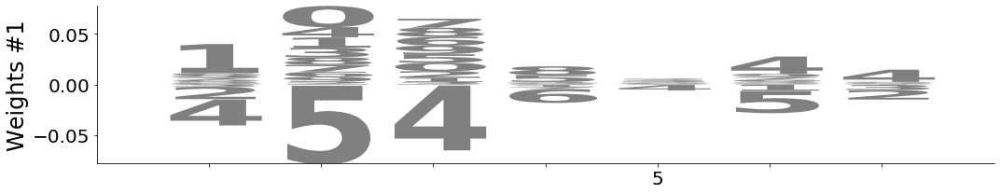

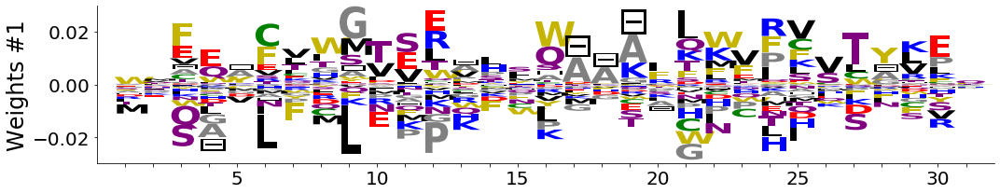

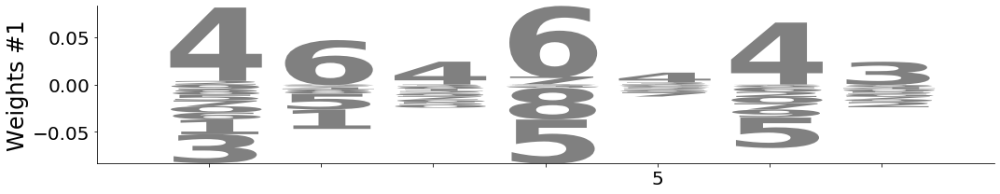

In [22]:
max_acti = model.edges[("sequence", "hidden")].get_weights().detach().view(-1, 21, 31).permute(0,2,1)
max_acti[:,:,0], max_acti[:,:,-1] = max_acti[:,:,-1], max_acti[:,:,0]
max_acti2 = model.edges[("structure", "hidden")].get_weights().detach().view(-1, 10, 7).permute(0,2,1)

order = np.argsort(get_beta(max_acti))[::-1]
for i in order:
    sequence_logo.Sequence_logo_multiple(max_acti.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)
    structure_logo.Sequence_logo_multiple(max_acti2.numpy()[i:i+1], figsize=(15,3) ,ticks_every=5,ticks_labels_size=20,title_size=24)